#### Author: Adam Van Etten - September 2021

# Notebook for prepping VisDrone data

### For this version, we focus only on vehicles, and discard the other labels

https://github.com/VisDrone/VisDrone-Dataset
https://github.com/VisDrone/VisDrone2018-DET-toolkit

VisDrone Labels:

    '<bbox_left>,<bbox_top>,<bbox_width>,<bbox_height>,<score>,<object_category>,<truncation>,<occlusion>'

    object_category: The object category indicates the type of annotated object:
    ignored regions(0), pedestrian(1), people(2), bicycle(3), car(4), van(5), truck(6), tricycle(7), awning-tricycle(8), bus(9), motor(10), others(11))
    
We'll ignore most of those classes and focus on: car(0), van(1), truck(2), bus(3)


---------


Run this notebook in a a [solaris](https://github.com/CosmiQ/solaris) docker environment:

    nvidia-docker run -itd -v /local_data:/local_data  -p 9111:9111 -ti --ipc=host --name camo_sol solaris_gpu_image2
    docker start camo_sol
    docker attach camo_sol
    conda activate solaris
    jupyter notebook --ip 0.0.0.0 --port=9111 --no-browser --allow-root &


-----

## Legacy papers of greatest utility to this study

### Fooling automated surveillance cameras: adversarial patches to attack person detection (https://arxiv.org/abs/1904.08653)

### ADVERSARIAL PATCH CAMOUFLAGE AGAINST AERIAL DETECTION (https://arxiv.org/abs/2008.13671 (Aug 2020)

In [1]:
from shapely.affinity import translate
from shapely.geometry import box
import matplotlib.pyplot as plt
from shapely.wkt import loads
import matplotlib as mpl
import geopandas as gpd
from torch import optim
from imp import reload
from tqdm import tqdm
import pandas as pd 
import numpy as np
import collections
import skimage.io
import operator
import shapely
import random
import shutil
import time
import imp
import cv2
import sys
import os
import gc
from torch import autograd
import torch
import PIL
from torchvision import transforms

# # camo src
# camo_path = '/local_data/cosmiq/src/avanetten/camouflage/'
# sys.path.append(os.path.join(camo_path, 'data_prep'))
# sys.path.append(os.path.join(camo_path, 'adversarial-yolt'))
# import cowc_yolt_prep
# import utils as camo_utils
# import prep_train as camo_prep_train
# import load_data
# import patch_config

# yolt src
yoltv4_path = '/local_data/cosmiq/src/avanetten/yoltv4/'
sys.path.append(os.path.join(yoltv4_path, 'yoltv4'))
import prep_train
import tile_ims_labels
import post_process

# patch data
patch_data_root = '/local_data/cosmiq/src/avanetten/camouflage/data/patches'

# set raw dataset path
data_root = '/local_data/cosmiq/wdata/avanetten/VisDrone/data'

# output dirs
train_root = os.path.join(data_root, 'VisDrone2019-DET-train')
val_root = os.path.join(data_root, 'VisDrone2019-DET-val')
test_root = os.path.join(data_root, 'VisDrone2019-DET-test-dev')

# experiment name
exp_name = 'v1_4cat'

In [10]:
# VisDrone labels

input_label_name_dict={0:'ignored', 1:'pedestrian', 2:'people', 3:'bicycle', 4:'car', 
                 5:'van', 6:'truck', 7:'tricycle', 8:'awning-tricycle', 9:'bus', 10:'motor', 11:'others'}
print("input_label_name_dict:", input_label_name_dict)

label_int_conv_dict = {4:0, 5:1, 6:2, 9:3}
print("label_int_conv_dict:", label_int_conv_dict)

label_str_dict={}
for k,v in label_int_conv_dict.items():
    label_str_dict[v] = input_label_name_dict[k]
print("label_str_dict:", label_str_dict)


input_label_name_dict: {0: 'ignored', 1: 'pedestrian', 2: 'people', 3: 'bicycle', 4: 'car', 5: 'van', 6: 'truck', 7: 'tricycle', 8: 'awning-tricycle', 9: 'bus', 10: 'motor', 11: 'others'}
label_int_conv_dict: {4: 0, 5: 1, 6: 2, 9: 3}
label_str_dict: {0: 'car', 1: 'van', 2: 'truck', 3: 'bus'}


### Prelude

The code below analyzes number of training objects in the entire train set.  This is important since each tensor must be the same dimensions in pytorch.  So if we allow for 100 objects in each slice, then each tensor will have to be padded to be size 100.  Therefore, it makes the most sense to toss out training images with an abnormally large number of objects present.

Based on the cell below, we'll select 40 as the max number of objects per image.

Malformed label: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/annotations/9999974_00000_d_0000053.txt
All non-malformed labels non-null
n images: 6470
1 percentile: 5.0
5 percentile: 9.0
25 percentile: 24.0
50 percentile: 43.0
75 percentile: 72.0
95 percentile: 136.0
98 percentile: 178.0
99 percentile: 213.3099999999995
99.5 percentile: 251.65499999999975
99.9 percentile: 360.0
np.max(n_labels_per_image) 914
np.median(n_labels_per_image) 43.0
np.mean(n_labels_per_image) 54.643585780525505


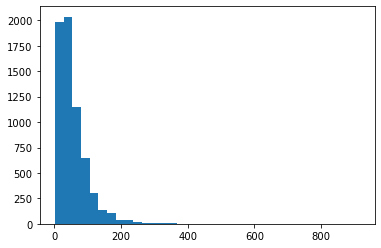

In [2]:
# check that all labels are non-null, and max number of labels per image
lab_dir, sep = os.path.join(train_root, 'annotations'), ','  # raw imagery
all_good = True
n_labels_per_image = []
for lab in [z for z in os.listdir(lab_dir) if z.endswith('.txt')]:
    lab_path = os.path.join(lab_dir, lab)
    # print(lab_path)
    if os.path.getsize(lab_path):       #check to see if label file contains data. 
        try:
            label = np.loadtxt(lab_path, delimiter=sep)
            n_labels = label.shape[0]
            n_labels_per_image.append(n_labels)
        except:
            print("Malformed label:", lab_path)
        continue
    else:
        print("Empty label:", lab_path)
        all_good = False
if all_good:
    print("All non-malformed labels non-null")
print("n images:", len(n_labels_per_image))
print("1 percentile:", np.percentile(n_labels_per_image, 1))
print("5 percentile:", np.percentile(n_labels_per_image, 5))
print("25 percentile:", np.percentile(n_labels_per_image, 25))
print("50 percentile:", np.percentile(n_labels_per_image, 50))
print("75 percentile:", np.percentile(n_labels_per_image, 75))
print("95 percentile:", np.percentile(n_labels_per_image, 95))
print("98 percentile:", np.percentile(n_labels_per_image, 98))
print("99 percentile:", np.percentile(n_labels_per_image, 99))
print("99.5 percentile:", np.percentile(n_labels_per_image, 99.5))
print("99.9 percentile:", np.percentile(n_labels_per_image, 99.9))
print("np.max(n_labels_per_image)", np.max(n_labels_per_image))
print("np.median(n_labels_per_image)", np.median(n_labels_per_image))
print("np.mean(n_labels_per_image)", np.mean(n_labels_per_image))
z = plt.hist(n_labels_per_image, bins=35)

path: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v0_11cat/labels
N training aircraft: 440295
training count breakdown:


car                178721
pedestrian         104569
motor               39608
people              34649
van                 32309
truck               16711
bicycle             13932
bus                  7748
tricycle             6082
awning-tricycle      3782
others               2184
Name: cat_str, dtype: int64

Text(0, 0.5, 'Number of Training Examples')

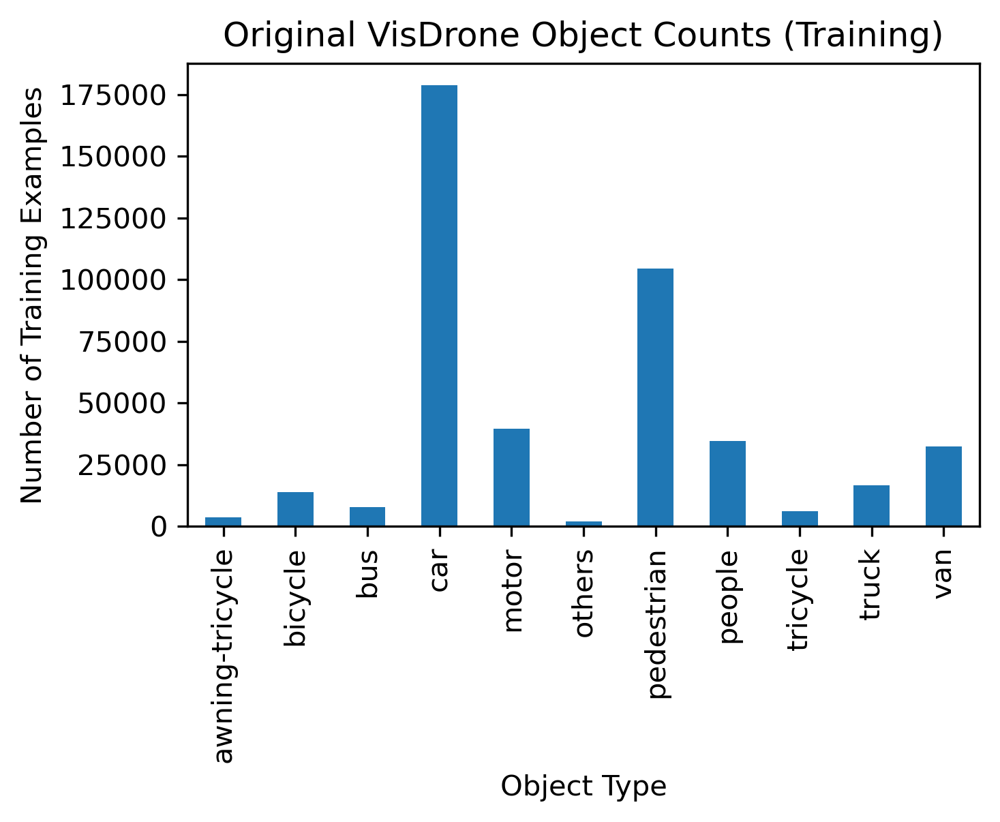

In [3]:
# Raw class counts
label_name_dict_prime = {0: 'pedestrian', 1: 'people', 2: 'bicycle', 3: 'car', 4: 'van', 5: 'truck', 6: 'tricycle', 7: 'awning-tricycle', 8: 'bus', 9: 'motor', 10: 'others'}
outdir_labels = os.path.join(train_root, 'yolt', 'v0_11cat', 'labels')
label_files = sorted([z for z in os.listdir(outdir_labels) if z.endswith('.txt')])
labels = []
for label_name in label_files:
    label_path = os.path.join(outdir_labels, label_name)
    df_tmp = pd.read_csv(label_path, sep=' ', names=['cat', 'a', 'b', 'c', 'd'])
    labels.extend(df_tmp['cat'].values)

df_tmp2 = pd.DataFrame(labels, columns=['cat'])
df_tmp2['cat_str'] = [label_name_dict_prime[z] for z in df_tmp2['cat']]
print("path:", outdir_labels)
print("N training aircraft:", len(df_tmp2))
print("training count breakdown:")
display(df_tmp2['cat_str'].value_counts(sort=True))

# plot
mpl.rcParams['figure.dpi'] = 300
# plot training counts
col_tmp = 'cat_str'
df_ft = df_tmp2.copy()
width = 0.5
fig, ax = plt.subplots(figsize=(5,3))
ax = df_ft[col_tmp].value_counts().sort_index().plot(kind='bar', ax=ax, log=False)
# if use_string_names:
#     # use aircraft name rather than integer?
#     labels_tmp_in = [item.get_text() for item in ax.get_xticklabels()]
#     labels_tmp_out = [name_to_pub_make_rev[int(item.get_text())] for item in ax.get_xticklabels()]
#     ax.set_xticklabels(labels_tmp_out, rotation=80)
_ = ax.set_title('Original VisDrone Object Counts (Training)')
ax.set_xlabel('Object Type')
ax.set_ylabel('Number of Training Examples')

In [5]:
# get bbox extents
sep = ','
colors = 40*[(255, 0, 0), (0, 255, 0), (0, 0, 255), (0, 140, 255),
              (0, 255, 125), (125, 125, 125), (140, 200, 0), (50, 200, 255),
              (0, 102, 0), (255, 0, 127), (51, 0, 105), (153, 0, 0), 
              (0, 128, 250), (255, 255, 100), (127, 0, 255), (153, 76, 0)]
col_names = ['bbox_left','bbox_top','bbox_width','bbox_height','score','object_category','truncation','occlusion']
# rand_selection = paths_tmp  # random.sample(paths_tmp, rows*cols)
image_dir_tmp = os.path.join(train_root, 'images')
label_dir_tmp = os.path.join(train_root, 'annotations')
image_names = os.listdir(image_dir_tmp)
idx_tmps = range(len(image_names)) #random.sample(range(len(image_names)), n_plots_tmp) # [5, 10, -5, -1]

# label_names = os.listdir(label_dir_tmp)
image_paths_tmp = [os.path.join(image_dir_tmp, image_names[z]) for z in idx_tmps]
# label_paths_tmp = [os.path.join(label_dir_tmp, label_names[z]) for z in idx_tmps]
dxs, dys, dtots, rs = [], [], [], []
for i in range(len(image_paths_tmp)):
    if (i % 500) == 0:
        print(i, "/", len(image_paths_tmp))
    im_path_tmp = image_paths_tmp[i] # rand_selection[i]
    name_root = os.path.basename(im_path_tmp).split('.')[0]
    label_path_tmp = os.path.join(label_dir_tmp, name_root + '.txt')
    # label_path_tmp = label_paths_tmp[i]
    # print("label_path_tmp:", label_path_tmp)
    im_name_tmp = os.path.basename(im_path_tmp)
    df_label_tmp = pd.read_csv(label_path_tmp, sep=sep, names=col_names, header=None)
    # im = skimage.io.imread(im_path_tmp)
    for idx_tmp, row in df_label_tmp.iterrows():
        cat_int = int(row['object_category'])
        color = colors[cat_int]
        xmin, xmax = row['bbox_left'], row['bbox_left'] + row['bbox_width']
        ymin, ymax = row['bbox_top'],  row['bbox_top'] + row['bbox_height']
        dx = xmax - xmin
        dy = ymax - ymin
        dxs.append(dx)
        dys.append(dy)
        dtots.append(max(dx, dy))
        rs.append(np.sqrt(dx*dx + dy*dy))

df_tmp3 = pd.DataFrame(data={'dx': dxs, 'dy': dys, 'dmax': dtots, 'r':rs})

0 / 6471
500 / 6471
1000 / 6471
1500 / 6471
2000 / 6471
2500 / 6471
3000 / 6471
3500 / 6471
4000 / 6471
4500 / 6471
5000 / 6471
5500 / 6471
6000 / 6471


n images: 353550
1 percentile: 6.0
5 percentile: 10.0
25 percentile: 20.0
50 percentile: 34.0
75 percentile: 59.0
95 percentile: 130.0
98 percentile: 179.0
99 percentile: 223.0
99.5 percentile: 267.0
99.9 percentile: 382.45100000005914
np.max(dlist) 1424.0
np.median(dlist) 34.0
np.mean(dlist) 47.57822938763965
np.std(dlist) 44.418052819730995


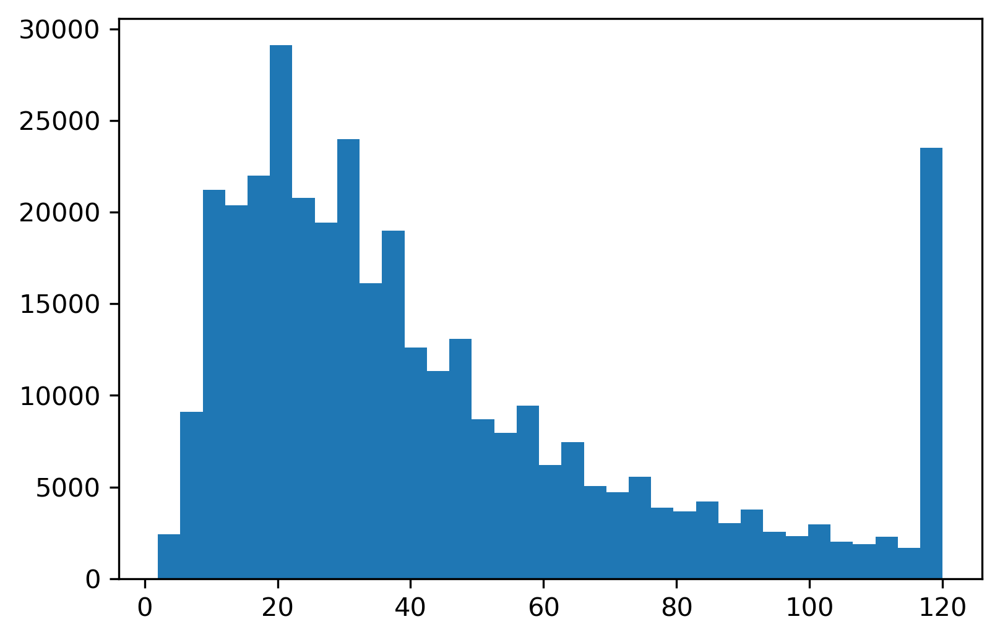

In [6]:
col_tmp = 'dmax'
dlist = df_tmp3[col_tmp].values
print("n images:", len(dlist))
print("1 percentile:", np.percentile(dlist, 1))
print("5 percentile:", np.percentile(dlist, 5))
print("25 percentile:", np.percentile(dlist, 25))
print("50 percentile:", np.percentile(dlist, 50))
print("75 percentile:", np.percentile(dlist, 75))
print("95 percentile:", np.percentile(dlist, 95))
print("98 percentile:", np.percentile(dlist, 98))
print("99 percentile:", np.percentile(dlist, 99))
print("99.5 percentile:", np.percentile(dlist, 99.5))
print("99.9 percentile:", np.percentile(dlist, 99.9))
print("np.max(dlist)", np.max(dlist))
print("np.median(dlist)", np.median(dlist))
print("np.mean(dlist)", np.mean(dlist))
print("np.std(dlist)", np.std(dlist))

#z = plt.hist(dlist, bins=50)
z = plt.hist(np.clip(dlist, 0, 120), bins=35)

### Explore some of the training data

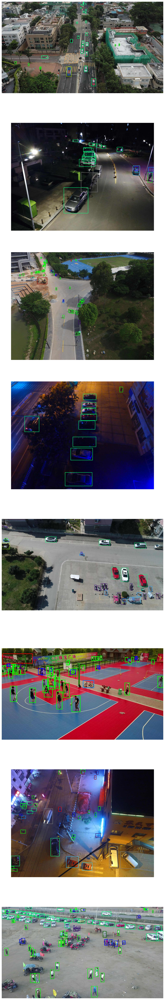

In [7]:
# explore some of the training data
n_plots_tmp = 8
sep = ','
col_names = ['bbox_left','bbox_top','bbox_width','bbox_height','score','object_category','truncation','occlusion']
# rand_selection = paths_tmp  # random.sample(paths_tmp, rows*cols)
image_dir_tmp = os.path.join(train_root, 'images')
label_dir_tmp = os.path.join(train_root, 'annotations')
colors = 40*[(255, 0, 0), (0, 255, 0), (0, 0, 255), (0, 140, 255),
              (0, 255, 125), (125, 125, 125), (140, 200, 0), (50, 200, 255),
              (0, 102, 0), (255, 0, 127), (51, 0, 105), (153, 0, 0), 
              (0, 128, 250), (255, 255, 100), (127, 0, 255), (153, 76, 0)]
image_names = os.listdir(image_dir_tmp)
idx_tmps = random.sample(range(len(image_names)), n_plots_tmp) # [5, 10, -5, -1]

# label_names = os.listdir(label_dir_tmp)
image_paths_tmp = [os.path.join(image_dir_tmp, image_names[z]) for z in idx_tmps]
# label_paths_tmp = [os.path.join(label_dir_tmp, label_names[z]) for z in idx_tmps]

# visualize some of the plots
rows, cols = len(idx_tmps), 1
figsize = 12
thickness = 2
fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize*cols, 0.8*figsize*rows))
# fig.suptitle(os.path.dirname(paths_tmp[0]))
for i in range(len(image_paths_tmp)):
    ax = axes.flatten()[i]
    im_path_tmp = image_paths_tmp[i] # rand_selection[i]
    name_root = os.path.basename(im_path_tmp).split('.')[0]
    label_path_tmp = os.path.join(label_dir_tmp, name_root + '.txt')
    # label_path_tmp = label_paths_tmp[i]
    # print("label_path_tmp:", label_path_tmp)
    im_name_tmp = os.path.basename(im_path_tmp)
    df_label_tmp = pd.read_csv(label_path_tmp, sep=sep, names=col_names, header=None)
    im = skimage.io.imread(im_path_tmp)
    for idx_tmp, row in df_label_tmp.iterrows():
        cat_int = int(row['object_category'])
        color = colors[cat_int]
        xmin, xmax = row['bbox_left'], row['bbox_left'] + row['bbox_width']
        ymin, ymax = row['bbox_top'],  row['bbox_top'] + row['bbox_height']
        # ymin, ymax = row['bbox_top'] - row['bbox_height'], row['bbox_top'] 
        # plot
        cv2.rectangle(im, (xmin, ymin),
                      (xmax, ymax), (color), thickness)
        ax.imshow(im)
    
    ax.axis('off')
    #ax.set_title(im_name_tmp + '  ' + str(im.shape))

In [13]:
# Tile and create yolt labels
reload(prep_train)

# We'll try: car(0), van(1), truck(2), bus(3)
# other labels will be discarded

input_label_name_dict={0:'ignored', 1:'pedestrian', 2:'people', 3:'bicycle', 4:'car', 
                 5:'van', 6:'truck', 7:'tricycle', 8:'awning-tricycle', 9:'bus', 10:'motor', 11:'others'}
print("input_label_name_dict:", input_label_name_dict)

label_int_conv_dict = {4:0, 5:1, 6:2, 9:3}
print("label_int_conv_dict:", label_int_conv_dict)

label_str_dict={}
for k,v in label_int_conv_dict.items():
    label_str_dict[v] = input_label_name_dict[k]
print("label_str_dict:", label_str_dict)

overwrite=False
window_size=416
overlap_frac=0.15
min_obj_frac=0.7
max_obj_count=1000
min_bbox_area_pix=225
max_occlusion_int=1
category_col='object_category'
category_prime_col='category_prime'
yolt_image_ext='.jpg'
label_col_names=['bbox_left','bbox_top','bbox_width','bbox_height','score','object_category','truncation','occlusion']

n_ims = 10000
image_dir_tmp = os.path.join(train_root, 'images')
label_dir_tmp = os.path.join(train_root, 'annotations')
outdir_ims = os.path.join(train_root, 'yolt', exp_name, 'images')
outdir_labels = os.path.join(train_root, 'yolt', exp_name, 'labels')
outdir_yolt_plots = os.path.join(train_root, 'yolt', exp_name, 'sample_label_vis_dir')
for z in [outdir_ims, outdir_labels, outdir_yolt_plots]:
    print(z)
    os.makedirs(z) #, exist_ok=True)

# get image names and paths
image_names = [z for z in os.listdir(image_dir_tmp) if z.endswith('.jpg')]
image_paths_tmp = sorted([os.path.join(image_dir_tmp, z) for z in image_names[:n_ims]])

# tile each image
for i,im_path_tmp in enumerate(image_paths_tmp):
    name_root = os.path.basename(im_path_tmp).split('.')[0]
    if (i % 100) == 0:
        print(i, "/", len(image_paths_tmp), name_root)
    label_path_tmp = os.path.join(label_dir_tmp, name_root + '.txt')
    prep_train.yolt_from_visdrone(im_path_tmp, label_path_tmp, 
                    geometry_col='geometry', 
                    category_col=category_col,
                    window_size=window_size, 
                    overlap_frac=overlap_frac,
                    min_obj_frac=min_obj_frac,
                    max_obj_count=max_obj_count,
                    outdir_ims=outdir_ims, 
                    outdir_labels=outdir_labels,
                    outdir_yolt_plots=outdir_yolt_plots,
                    yolt_image_ext=yolt_image_ext,
                    max_plots=20,
                    label_sep=',',
                    min_bbox_area_pix=min_bbox_area_pix,
                    max_occlusion_int=max_occlusion_int,
                    label_col_names=label_col_names,
                    input_label_name_dict=input_label_name_dict,
                    category_prime_col=category_prime_col,
                    label_int_conv_dict=label_int_conv_dict,
                    overwrite=overwrite,
                    verbose=True, super_verbose=False)

print("  outdir_yolt_plots:", outdir_yolt_plots)

input_label_name_dict: {0: 'ignored', 1: 'pedestrian', 2: 'people', 3: 'bicycle', 4: 'car', 5: 'van', 6: 'truck', 7: 'tricycle', 8: 'awning-tricycle', 9: 'bus', 10: 'motor', 11: 'others'}
label_int_conv_dict: {4: 0, 5: 1, 6: 2, 9: 3}
label_str_dict: {0: 'car', 1: 'van', 2: 'truck', 3: 'bus'}
/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/images


FileExistsError: [Errno 17] File exists: '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/images'

All non-malformed labels non-null
n images: 44493
1 percentile: 2.0
5 percentile: 2.0
25 percentile: 3.0
50 percentile: 5.0
75 percentile: 6.0
95 percentile: 15.0
98 percentile: 21.0
99 percentile: 26.0
99.5 percentile: 30.0
99.9 percentile: 37.0
np.max(n_labels_per_image) 40


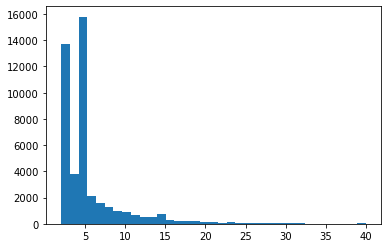

In [5]:
# check that all labels are non-null, and max number of labels per image
lab_dir, sep = os.path.join(train_root, 'yolt', exp_name, 'labels'), ' '  # sliced imagery
all_good = True
n_labels_per_image = []
for lab in [z for z in os.listdir(lab_dir) if z.endswith('.txt')]:
    lab_path = os.path.join(lab_dir, lab)
    # print(lab_path)
    if os.path.getsize(lab_path):       #check to see if label file contains data. 
        try:
            label = np.loadtxt(lab_path, delimiter=sep)
            n_labels = label.shape[0]
            n_labels_per_image.append(n_labels)
        except:
            print("Malformed label:", lab_path)
        continue
    else:
        print("Empty label:", lab_path)
        all_good = False
if all_good:
    print("All non-malformed labels non-null")
print("n images:", len(n_labels_per_image))
print("1 percentile:", np.percentile(n_labels_per_image, 1))
print("5 percentile:", np.percentile(n_labels_per_image, 5))
print("25 percentile:", np.percentile(n_labels_per_image, 25))
print("50 percentile:", np.percentile(n_labels_per_image, 50))
print("75 percentile:", np.percentile(n_labels_per_image, 75))
print("95 percentile:", np.percentile(n_labels_per_image, 95))
print("98 percentile:", np.percentile(n_labels_per_image, 98))
print("99 percentile:", np.percentile(n_labels_per_image, 99))
print("99.5 percentile:", np.percentile(n_labels_per_image, 99.5))
print("99.9 percentile:", np.percentile(n_labels_per_image, 99.9))
print("np.max(n_labels_per_image)", np.max(n_labels_per_image))
z = plt.hist(n_labels_per_image, bins=35)


label_str_dict: {0: 'car', 1: 'van', 2: 'truck', 3: 'bus'}
path: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/labels
N training objects: 199969
training count breakdown:


car      148714
van       28917
truck     14970
bus        7368
Name: cat_str, dtype: int64

Text(0, 0.5, 'Number of Training Examples')

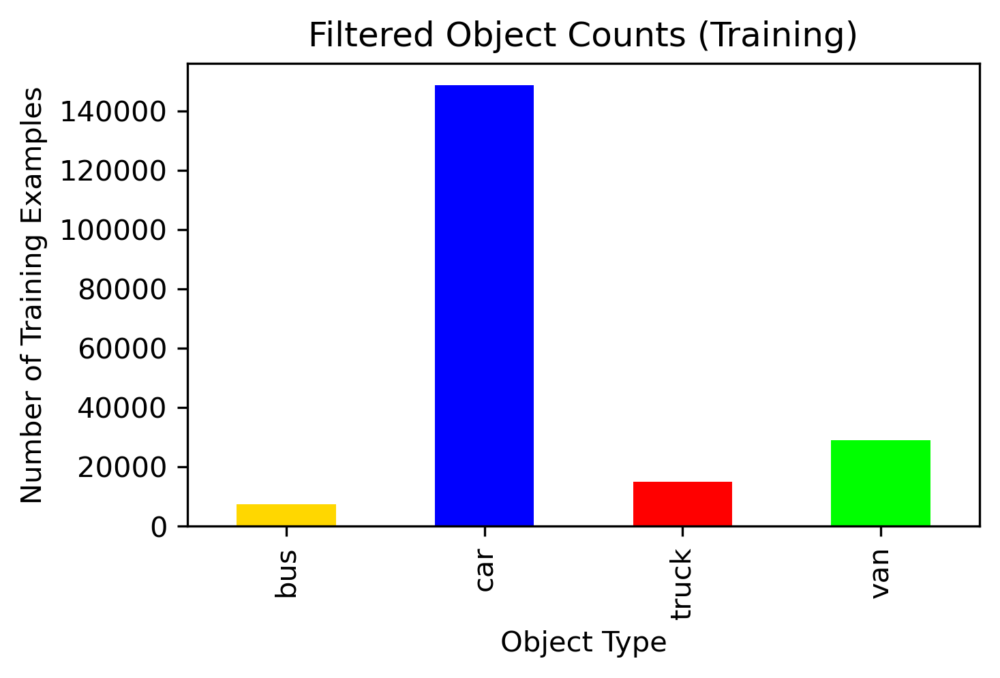

In [11]:
# class counts for 4cat_v1
print("label_str_dict:", label_str_dict)
outdir_labels = os.path.join(train_root, 'yolt', exp_name, 'labels')
label_files = sorted([z for z in os.listdir(outdir_labels) if z.endswith('.txt')])
labels = []
for label_name in label_files:
    label_path = os.path.join(outdir_labels, label_name)
    df_tmp = pd.read_csv(label_path, sep=' ', names=['cat', 'a', 'b', 'c', 'd'])
    labels.extend(df_tmp['cat'].values)

df_tmp2 = pd.DataFrame(labels, columns=['cat'])
df_tmp2['cat_str'] = [label_str_dict[z] for z in df_tmp2['cat']]
print("path:", outdir_labels)
print("N training objects:", len(df_tmp2))
print("training count breakdown:")
display(df_tmp2['cat_str'].value_counts(sort=True))

# plot
mpl.rcParams['figure.dpi'] = 300
# plot training counts
col_tmp = 'cat_str'
df_ft = df_tmp2.copy()
width = 0.5
fig, ax = plt.subplots(figsize=(5,3))
ax = df_ft[col_tmp].value_counts().sort_index().plot(kind='bar', ax=ax, log=False,
                                                    color=['gold', 'blue', 'red', 'lime']
                                                    )
_ = ax.set_title('Filtered Object Counts (Training)')
ax.set_xlabel('Object Type')
ax.set_ylabel('Number of Training Examples')

In [13]:
# move images with too many labels
max_labels_per_slice = 40
sep = ' '
outdir_ims = os.path.join(train_root, 'yolt', exp_name, 'images')
outdir_labels = os.path.join(train_root, 'yolt', exp_name, 'labels')
outdir_ims_mal = os.path.join(train_root, 'yolt', exp_name, 'images_busy')
outdir_labels_mal = os.path.join(train_root, 'yolt', exp_name, 'labels_busy')
for z in [outdir_ims_mal, outdir_labels_mal]:
    print(z)
    os.makedirs(z, exist_ok=True)

n_labels_per_image = []
for lab in [z for z in os.listdir(outdir_labels) if z.endswith('.txt')]:
    name_root = os.path.basename(lab).split('.')[0]
    lab_path = os.path.join(outdir_labels, lab)
    im_path = os.path.join(outdir_ims, name_root + '.jpg')
    label = np.loadtxt(lab_path, delimiter=sep)
    n_labels = label.shape[0]
    n_labels_per_image.append(n_labels)
    # move if too busy
    if n_labels > max_labels_per_slice:
        print("Moving", name_root, "with", n_labels, "labels")
        shutil.move(im_path, outdir_ims_mal)
        shutil.move(lab_path, outdir_labels_mal)

!ls {outdir_labels_mal} | wc -l

/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/images_busy
/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/labels_busy
Moving 9999951_00000_d_0000233__x0_0_y0_0_dxdy_416 with 46 labels
Moving 0000126_03402_d_0000128__x0_706_y0_0_dxdy_416 with 47 labels
Moving 0000293_02601_d_0000935__x0_353_y0_0_dxdy_416 with 51 labels
Moving 0000275_00601_d_0000500__x0_706_y0_0_dxdy_416 with 42 labels
Moving 0000126_11844_d_0000130__x0_353_y0_353_dxdy_416 with 53 labels
Moving 0000325_03001_d_0000677__x0_353_y0_0_dxdy_416 with 46 labels
Moving 9999951_00000_d_0000239__x0_0_y0_0_dxdy_416 with 43 labels
Moving 9999945_00000_d_0000123__x0_353_y0_0_dxdy_416 with 45 labels
Moving 9999951_00000_d_0000184__x0_353_y0_353_dxdy_416 with 53 labels
Moving 0000142_04058_d_0000043__x0_353_y0_0_dxdy_416 with 46 labels
Moving 9999940_00000_d_0000090__x0_353_y0_0_dxdy_416 with 46 labels
Moving 0000225_04002_d_0000013__x0_353_y0_0_dxdy_416 with 

In [16]:
# visualize some of the labeled (ground truth) plots
rows, cols = 3,3
figsize = 12
image_paths_tmp_all = [os.path.join(outdir_yolt_plots, z) for z in os.listdir(outdir_yolt_plots)]
image_paths_tmp = random.sample(image_paths_tmp_all, rows*cols)

fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize*cols, 0.75*figsize*rows))
for i in range(rows*cols):
    ax = axes.flatten()[i]
    im_path_tmp = image_paths_tmp[i] # rand_selection[i]
    im = skimage.io.imread(im_path_tmp)
    ax.imshow(im)
    ax.axis('off')
    # ax.set_title(os.path.basename(im_path_tmp) + '  ' + str(im.shape))
plt.tight_layout()

### Val and Test

In [17]:
# Exact same cell as above that splits training data, just with val_root or test_root replacing train_root

# Tile and create yolt labels
reload(prep_train)

overwrite=False
window_size=416
overlap_frac=0.15
min_obj_frac=0.7
max_obj_count=1000
min_bbox_area_pix=225
max_occlusion_int=1
category_col='object_category'
category_prime_col='category_prime'
yolt_image_ext='.jpg'
label_col_names=['bbox_left','bbox_top','bbox_width','bbox_height','score','object_category','truncation','occlusion']
n_ims = 10000

for tmp_root in [val_root, test_root]:
    print("Dir:", tmp_root)
    image_dir_tmp = os.path.join(tmp_root, 'images')
    label_dir_tmp = os.path.join(tmp_root, 'annotations')
    outdir_ims = os.path.join(tmp_root, 'yolt', exp_name, 'images')
    outdir_labels = os.path.join(tmp_root, 'yolt', exp_name, 'labels')
    outdir_yolt_plots = os.path.join(tmp_root, 'yolt', exp_name, 'sample_label_vis_dir')
    for z in [outdir_ims, outdir_labels, outdir_yolt_plots]:
        print(z)
        os.makedirs(z) #, exist_ok=True)

    # get image names and paths
    image_names = [z for z in os.listdir(image_dir_tmp) if z.endswith('.jpg')]
    image_paths_tmp = sorted([os.path.join(image_dir_tmp, z) for z in image_names[:n_ims]])

    # tile each image
    for i,im_path_tmp in enumerate(image_paths_tmp):
        name_root = os.path.basename(im_path_tmp).split('.')[0]
        if (i % 100) == 0:
            print(i, "/", len(image_paths_tmp), name_root)
        label_path_tmp = os.path.join(label_dir_tmp, name_root + '.txt')
        prep_train.yolt_from_visdrone(im_path_tmp, label_path_tmp, 
                        geometry_col='geometry', 
                        category_col=category_col,
                        window_size=window_size, 
                        overlap_frac=overlap_frac,
                        min_obj_frac=min_obj_frac,
                        max_obj_count=max_obj_count,
                        outdir_ims=outdir_ims, 
                        outdir_labels=outdir_labels,
                        outdir_yolt_plots=outdir_yolt_plots,
                        yolt_image_ext=yolt_image_ext,
                        max_plots=20,
                        label_sep=',',
                        min_bbox_area_pix=min_bbox_area_pix,
                        max_occlusion_int=max_occlusion_int,
                        label_col_names=label_col_names,
                        input_label_name_dict=input_label_name_dict,
                        category_prime_col=category_prime_col,
                        label_int_conv_dict=label_int_conv_dict,
                        overwrite=overwrite,
                        verbose=True, super_verbose=False)

    print("  outdir_yolt_plots:", outdir_yolt_plots)

Dir: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-val
/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-val/yolt/v1_4cat/images


FileExistsError: [Errno 17] File exists: '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-val/yolt/v1_4cat/images'

In [6]:
# create single ground truth json from labels (for plotting) 
reload(prep_train)
im_dir_tmp = '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/images'
lab_dir_tmp = '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/labels'
outfile_gdf = '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/gdf_pix_tot.geojson'

input_label_name_dict={0:'ignored', 1:'pedestrian', 2:'people', 3:'bicycle', 4:'car', 
                 5:'van', 6:'truck', 7:'tricycle', 8:'awning-tricycle', 9:'bus', 10:'motor', 11:'others'}
print("input_label_name_dict:", input_label_name_dict)

label_int_conv_dict = {4:0, 5:1, 6:2, 9:3}
print("label_int_conv_dict:", label_int_conv_dict)

label_str_dict={}
for k,v in label_int_conv_dict.items():
    label_str_dict[v] = input_label_name_dict[k]
print("label_str_dict:", label_str_dict)

# execute 
reload(prep_train)
prep_train.labels_to_json_single(im_dir_tmp, lab_dir_tmp, outfile_gdf, im_ext='.jpg', 
                   out_cols=['im_name_root', 'image_path', 'label_path', 'label_int', 'category', 'geometry'],
                   label_str_dict=label_str_dict,
                   verbose=False)


input_label_name_dict: {0: 'ignored', 1: 'pedestrian', 2: 'people', 3: 'bicycle', 4: 'car', 5: 'van', 6: 'truck', 7: 'tricycle', 8: 'awning-tricycle', 9: 'bus', 10: 'motor', 11: 'others'}
label_int_conv_dict: {4: 0, 5: 1, 6: 2, 9: 3}
label_str_dict: {0: 'car', 1: 'van', 2: 'truck', 3: 'bus'}
0 / 11236 0000278_02351_d_0000002__x0_944_y0_0_dxdy_416
100 / 11236 9999963_00000_d_0000026__x0_706_y0_0_dxdy_416
200 / 11236 9999952_00000_d_0000178__x0_353_y0_372_dxdy_416
300 / 11236 9999938_00000_d_0000171__x0_706_y0_353_dxdy_416
400 / 11236 0000187_00444_d_0000190__x0_544_y0_124_dxdy_416
500 / 11236 9999973_00000_d_0000091__x0_1412_y0_0_dxdy_416
600 / 11236 9999938_00000_d_0000463__x0_706_y0_353_dxdy_416
700 / 11236 9999973_00000_d_0000091__x0_1059_y0_662_dxdy_416
800 / 11236 9999973_00000_d_0000132__x0_1059_y0_662_dxdy_416
900 / 11236 9999952_00000_d_0000190__x0_706_y0_353_dxdy_416
1000 / 11236 9999986_00000_d_0000027__x0_984_y0_353_dxdy_416
1100 / 11236 9999941_00000_d_0000012__x0_706_y0_372

In [ ]:
# create individual jsons from labels (for scoring)
reload(prep_train)
im_dir_tmp = '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/images'
lab_dir_tmp = '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/labels'
out_gdf_dir = '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/gdf_pix'

# execute 
prep_train.labels_to_json(im_dir_tmp, lab_dir_tmp, out_gdf_dir, im_ext='.jpg', 
                   out_cols=['image_fname', 'image_path', 'label_path', 'label_int', 'label_str', 'geometry'],
                   label_str_dict=label_str_dict,
                   verbose=False)


In [18]:
# # visualize some of the plots for val or test
# print("outdir_yolt_plots:", outdir_yolt_plots)
# rows, cols = 4, 2
# figsize = 12
# image_paths_tmp_all = [os.path.join(outdir_yolt_plots, z) for z in os.listdir(outdir_yolt_plots)]
# image_paths_tmp = random.sample(image_paths_tmp_all, rows*cols)
# ### Copy labels to image dir

# fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize*cols, 0.8*figsize*rows))
# for i in range(rows*cols):
#     ax = axes.flatten()[i]
#     im_path_tmp = image_paths_tmp[i] # rand_selection[i]
#     im = skimage.io.imread(im_path_tmp)
#     ax.imshow(im)
#     ax.set_title(os.path.basename(im_path_tmp) + '  ' + str(im.shape))

In [19]:
# move images with too many labels
max_labels_per_slice = 40
sep = ' '
outdir_ims = os.path.join(val_root, 'yolt', exp_name, 'images')
outdir_labels = os.path.join(val_root, 'yolt', exp_name, 'labels')
outdir_ims_mal = os.path.join(val_root, 'yolt', exp_name, 'images_busy')
outdir_labels_mal = os.path.join(val_root, 'yolt', exp_name, 'labels_busy')
for z in [outdir_ims_mal, outdir_labels_mal]:
    os.makedirs(z, exist_ok=True)

n_labels_per_image = []
for lab in [z for z in os.listdir(outdir_labels) if z.endswith('.txt')]:
    name_root = os.path.basename(lab).split('.')[0]
    lab_path = os.path.join(outdir_labels, lab)
    im_path = os.path.join(outdir_ims, name_root + '.jpg')
    label = np.loadtxt(lab_path, delimiter=sep)
    n_labels = label.shape[0]
    n_labels_per_image.append(n_labels)
    # move if too busy
    if n_labels > max_labels_per_slice:
        print("Moving", name_root, "with", n_labels, "labels")
        shutil.move(im_path, outdir_ims_mal)
        shutil.move(lab_path, outdir_labels_mal)

Moving 0000291_03201_d_0000884__x0_706_y0_0_dxdy_416 with 46 labels
Moving 0000295_01800_d_0000030__x0_353_y0_0_dxdy_416 with 42 labels
Moving 0000291_05201_d_0000893__x0_353_y0_0_dxdy_416 with 45 labels
Moving 0000295_02000_d_0000031__x0_353_y0_0_dxdy_416 with 42 labels
Moving 0000295_01800_d_0000030__x0_706_y0_0_dxdy_416 with 44 labels
Moving 0000295_01800_d_0000030__x0_706_y0_349_dxdy_416 with 41 labels


## Test

In [2]:
# Copy labels to image dir
# For yolov4, images need to be in the same folder as images for training

# train
outdir_ims = os.path.join(train_root, 'yolt', exp_name, 'images')
outdir_labels = os.path.join(train_root, 'yolt', exp_name, 'labels')
for f in os.listdir(outdir_labels):
    if f.endswith('.txt'):
        shutil.copy(os.path.join(outdir_labels, f), outdir_ims)### Copy labels to image dir

# val
outdir_ims = os.path.join(val_root, 'yolt', exp_name, 'images')
outdir_labels = os.path.join(val_root, 'yolt', exp_name, 'labels')
for f in os.listdir(outdir_labels):
    if f.endswith('.txt'):
        shutil.copy(os.path.join(outdir_labels, f), outdir_ims)### Copy labels to image dir

In [24]:
# create txt files of image paths

# train
name_tmp = 'visdrone_train_list_' + exp_name + '.txt'
im_dir_tmp = os.path.join(train_root, 'yolt', exp_name, 'images')
txt_dir_tmp =   os.path.join(train_root, 'yolt', exp_name, 'txt')
os.makedirs(txt_dir_tmp, exist_ok=True)
outpath_txt_tmp = os.path.join(txt_dir_tmp, name_tmp)
im_list = [os.path.join(im_dir_tmp, z) for z in os.listdir(im_dir_tmp) if z.endswith('.jpg')]
df_tmp = pd.DataFrame({'image': im_list})
df_tmp.to_csv(outpath_txt_tmp, header=False, index=False)
print("Train outpath:", outpath_txt_tmp)
print("N train images:", len(df_tmp))

# val
name_tmp = 'visdrone_val_list_' + exp_name + '.txt'
im_dir_tmp = os.path.join(val_root, 'yolt', exp_name, 'images')
txt_dir_tmp =   os.path.join(val_root, 'yolt', exp_name, 'txt')
os.makedirs(txt_dir_tmp, exist_ok=True)
outpath_txt_tmp = os.path.join(txt_dir_tmp, name_tmp)
im_list = [os.path.join(im_dir_tmp, z) for z in os.listdir(im_dir_tmp) if z.endswith('.jpg')]
df_tmp = pd.DataFrame({'image': im_list})
df_tmp.to_csv(outpath_txt_tmp, header=False, index=False)
print("Val outpath:", outpath_txt_tmp)
print("N val images:", len(df_tmp))

# test
name_tmp = 'visdrone_test_list_' + exp_name + '.txt'
im_dir_tmp = os.path.join(test_root, 'yolt', exp_name, 'images')
txt_dir_tmp =   os.path.join(test_root, 'yolt', exp_name, 'txt')
os.makedirs(txt_dir_tmp, exist_ok=True)
outpath_txt_tmp = os.path.join(txt_dir_tmp, name_tmp)
im_list = [os.path.join(im_dir_tmp, z) for z in os.listdir(im_dir_tmp) if z.endswith('.jpg')]
df_tmp = pd.DataFrame({'image': im_list})
df_tmp.to_csv(outpath_txt_tmp, header=False, index=False)
print("Val outpath:", outpath_txt_tmp)
print("N val images:", len(df_tmp))

Train outpath: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/txt/visdrone_train_list_v1_4cat.txt
N train images: 44493
Val outpath: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-val/yolt/v1_4cat/txt/visdrone_val_list_v1_4cat.txt
N val images: 2912
Val outpath: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/txt/visdrone_test_list_v1_4cat.txt
N val images: 11236


### Make .names (list of names for each category, in a file)

In [33]:
# make .names file
print("label_str_dict:", label_str_dict)
txt_dir_tmp =   os.path.join(train_root, 'yolt', exp_name, 'txt')
names_file = os.path.join(txt_dir_tmp, 'visdrone_' + exp_name + '.names')
sorted_keys = sorted(label_str_dict.keys())
for i,k in enumerate(sorted_keys):
    v = label_str_dict[k]
    # print(k, v)
    if i == 0:
        !echo {v} > {names_file}
    else:
        !echo {v} >> {names_file}
    
print("outfile:", names_file)
!cat {names_file}
# copy to test dir as well
os.makedirs(os.path.join(test_root, 'yolt', exp_name, 'txt'), exist_ok=True)
!cp {names_file} {os.path.join(test_root, 'yolt', exp_name, 'txt')}

label_str_dict: {0: 'car', 1: 'van', 2: 'truck', 3: 'bus'}
outfile: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/txt/visdrone_v1_4cat.names
car
van
truck
bus


### Create .data files

Create file _.data in the directory build\darknet\x64\data\

Should look something like:

    classes = 1
    train  = /wdata/train.txt
    valid  = /wdata/valid.txt
    names = data/fun.names
    backup = backup/

In [27]:
#################
# create .data file

# set variables
outdir_txt =   os.path.join(train_root, 'yolt', exp_name, 'txt')
outdir_txt_val =   os.path.join(val_root, 'yolt', exp_name, 'txt')

namefile = os.path.join(outdir_txt, 'visdrone_' + exp_name + '.names')
outfile = os.path.join(outdir_txt,  'visdrone_' + exp_name + '_train.data')
class_num = len(label_str_dict.keys())
outpath_train_list = os.path.join(outdir_txt, 'visdrone_train_list_' + exp_name + '.txt')
outpath_valid_list = os.path.join(outdir_txt_val, 'visdrone_val_list_' + exp_name + '.txt')

# write to file
!echo 'classes = ' {class_num} > {outfile}
!echo 'train = ' {outpath_train_list} >> {outfile}
!echo 'valid = ' {outpath_valid_list} >> {outfile}
!echo 'names = ' {namefile} >> {outfile}
!echo 'backup = backup/' >> {outfile}

print("\ncat:", outfile)
!cat {outfile}

# # copy to yolt data dir?
# yolt_data_dir = os.path.join(yoltv4_path, 'darknet', 'data')
# !cp {outfile} {yolt_data_dir}


cat: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/txt/visdrone_v1_4cat_train.data
classes =  4
train =  /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/txt/visdrone_train_list_v1_4cat.txt
valid =  /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-val/yolt/v1_4cat/txt/visdrone_val_list_v1_4cat.txt
names =  /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-train/yolt/v1_4cat/txt/visdrone_v1_4cat.names
backup = backup/


### Create testing .data file

In [26]:
#################
# create testing .data file

# set variables
outdir_txt =   os.path.join(test_root, 'yolt', exp_name, 'txt')
namefile = os.path.join(outdir_txt, 'visdrone_' + exp_name + '.names')
outfile = os.path.join(outdir_txt,  'visdrone_test_' + exp_name + '.data')
class_num = len(label_str_dict.keys())
outpath_train_list = ''
outpath_valid_list = os.path.join(outdir_txt, 'visdrone_test_list_' + exp_name + '.txt')

# write to file
!echo 'classes = ' {class_num} > {outfile}
!echo 'train = ' {outpath_train_list} >> {outfile}
!echo 'valid = ' {outpath_valid_list} >> {outfile}
!echo 'names = ' {namefile} >> {outfile}
!echo 'backup = backup/' >> {outfile}

print("\nhead:", outfile)
!cat {outfile}

# # copy to yolt data dir?
# yolt_data_dir = os.path.join(yoltv4_path, 'darknet', 'data')
# !cp {outfile} {yolt_data_dir}


head: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/txt/visdrone_test_v1_4cat.data
classes =  4
train = 
valid =  /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/txt/visdrone_test_list_v1_4cat.txt
names =  /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/txt/visdrone_v1_4cat.names
backup = backup/


## Data is now prepped, so proceed with setting up the cfg file and launching training

https://github.com/AlexeyAB/darknet#how-to-train-to-detect-your-custom-objects

change line batch to batch=64

change line subdivisions to subdivisions=16

change line max_batches to (classes*2000 but not less than number of training images, but not less than number of training images and not less than 6000), f.e. max_batches=6000 if you train for 3 classes

#### for yolov4 cfgs
change line steps to 80% and 90% of max_batches, f.e. steps=4800,5400
set network size width=416 height=416 or any value multiple of 32
change line classes=80 to your number of objects in each of 3 [yolo]-layers:
change [filters=255] to filters=(classes + 5)x3 in the 3 [convolutional] before each [yolo] layer, keep in mind that it only has to be the last [convolutional] before each of the [yolo] layers.
    So if classes=1 then should be filters=18. If classes=2 then write filters=21.

#### for yolov2:
set the final filters to: filters = (classes + 5) * 5
(https://manivannan-ai.medium.com/how-to-train-yolov2-to-detect-custom-objects-9010df784f36)